<a href="https://colab.research.google.com/github/PranshuSwaroop15/AutomaticSpeechRecognition_Using_Wav2Vec2_Model/blob/main/AutomaticSpeechRecognitionUsingWav2Vec2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Importing Dependencies**

In [1]:
import torch

import torchaudio

print(torch.__version__)
print(torchaudio.__version__)

torch.random.manual_seed(0)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

print(device)

2.3.0+cu121
2.3.0+cu121
cpu


# 2.Uploading the DataFiles

In [30]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import IPython
import matplotlib.pyplot as plt
from torchaudio.utils import download_asset
import librosa
import librosa.display

SPEECH_FILE = download_asset("/content/Voice-Overs in 60 Seconds.wav")

In [3]:
pipeline = torchaudio.pipelines.WAV2VEC2_ASR_BASE_960H

print("Sample Rate:", pipeline.sample_rate)

print("Labels:", pipeline.get_labels())

Sample Rate: 16000
Labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')


In [4]:
model = pipeline.get_model().to(device)

print(model.__class__)

<class 'torchaudio.models.wav2vec2.model.Wav2Vec2Model'>


In [5]:
IPython.display.Audio(SPEECH_FILE)

In [6]:
waveform, sample_rate = torchaudio.load(SPEECH_FILE)
waveform = waveform.to(device)

if sample_rate != pipeline.sample_rate:
    waveform = torchaudio.functional.resample(waveform, sample_rate, pipeline.sample_rate)

In [7]:
with torch.inference_mode():
    features, _ = model.extract_features(waveform)

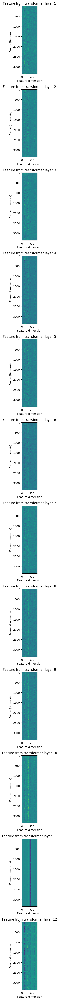

In [8]:
fig, ax = plt.subplots(len(features), 1, figsize=(16, 4.3 * len(features)))
for i, feats in enumerate(features):
    ax[i].imshow(feats[0].cpu(), interpolation="nearest")
    ax[i].set_title(f"Feature from transformer layer {i+1}")
    ax[i].set_xlabel("Feature dimension")
    ax[i].set_ylabel("Frame (time-axis)")
fig.tight_layout()

In [9]:
with torch.inference_mode():
    emission, _ = model(waveform)

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')


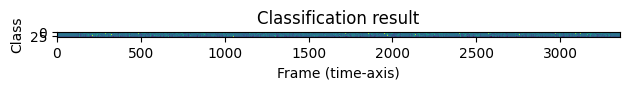

In [10]:
plt.imshow(emission[0].cpu().T, interpolation="nearest")
plt.title("Classification result")
plt.xlabel("Frame (time-axis)")
plt.ylabel("Class")
plt.tight_layout()
print("Class labels:", pipeline.get_labels())

In [11]:
class GreedyCTCDecoder(torch.nn.Module):
    def __init__(self, labels, blank=0):
        super().__init__()
        self.labels = labels
        self.blank = blank

    def forward(self, emission: torch.Tensor) -> str:
        """Given a sequence emission over labels, get the best path string
        Args:
          emission (Tensor): Logit tensors. Shape `[num_seq, num_label]`.

        Returns:
          str: The resulting transcript
        """
        indices = torch.argmax(emission, dim=-1)  # [num_seq,]
        indices = torch.unique_consecutive(indices, dim=-1)
        indices = [i for i in indices if i != self.blank]
        return "".join([self.labels[i] for i in indices])

In [12]:
decoder = GreedyCTCDecoder(labels=pipeline.get_labels())
transcript = decoder(emission[0])

In [13]:
print(transcript)
IPython.display.Audio(SPEECH_FILE)

THE|VOICE|OVER|IS|THE|UNSEEN|PERSON|WHO|NARRATES|THAT|COULD|BE|IN|A|COMMERCIAL|A|DOCUMENTARY|OR|EVEN|IN|FICTION|THE|RIGHT|VOICE|WITH|THE|RIGHT|TONE|PACE|AND|CHARACTER|FOR|YOUR|PROJECT|WILL|RESULT|IN|A|POLISHED|AND|PROFESSIONAL|RESULT|THE|WRONG|OR|AMETER|VOICE|WILL|POSSIBLY|DESTROY|EVERYTHING|ELSE|YOU|PUT|INTO|YOUR|PROJECT|VOICE|OVERS|USE|A|VARIETY|OF|KEY|WORDS|TO|GET|THE|TONE|RIGHT|PRODUCERS|WILL|TELL|THE|ARTISTS|TO|BE|REASSURING|AGGRESSIVE|FRIENDLY|AUTHORITATIVE|AND|SO|ON|WHEN|LOOKING|FOR|THE|RIGHT|VOICE|YOU|HAVE|TO|ASK|YOURSELF|SOME|KEY|QUESTIONS|WHO|IS|MY|INTENDED|AUDIENCE|AND|WHAT|TYPE|OF|VOICE|WILL|RELATE|TO|THEM|BEST|WOOLDLY|INFORMATION|BE|BEST|RELAID|BY|A|MAN|OR|A|WOMAN|SOME|ONE|OLDER|OR|YOUNGER|HOW|WILL|THE|VOICE|FIT|BEST|WITH|THE|REST|OF|THE|PRODUCTION|THE|TECHNICAL|QUALITY|OF|THE|RECORDING|IS|ALSO|ESSENTIAL|TAKE|TIME|CHOOSING|YOUR|VOICE|OVER|AND|KNOW|THAT|THEY|WILL|CARRY|THE|NARRATIVE|MAKE|THAT|CHOICE|VERY|CAREFULLY|AND|NEVER|AS|A|RUSHED|AFTERTHOUGHT|I|MARK|THOUBURN|AND|THAT|

In [14]:
!pip install gradio

In [15]:
!pip install gradio torch torchaudio transformers


In [28]:
import gradio as gr
import torch
from transformers import Wav2Vec2ForCTC, Wav2Vec2Processor
import torchaudio
import multiprocessing as mp

# Load the Wav2Vec2 model and processor
model_name = "facebook/wav2vec2-base-960h"
processor = Wav2Vec2Processor.from_pretrained(model_name)
model = Wav2Vec2ForCTC.from_pretrained(model_name)

# Function to process a single chunk of audio
def process_chunk(chunk, sample_rate):
    # Resample the audio to 16000 Hz if necessary
    if sample_rate != 16000:
        resampler = torchaudio.transforms.Resample(orig_freq=sample_rate, new_freq=16000)
        chunk = resampler(chunk)

    # Ensure the audio is in the correct format
    chunk = chunk.squeeze().numpy()

    # Process the audio to the format expected by the model
    input_values = processor(chunk, sampling_rate=16000, return_tensors="pt").input_values

    # Perform inference
    with torch.no_grad():
        logits = model(input_values).logits

    # Decode the logits to get the predicted text
    predicted_ids = torch.argmax(logits, dim=-1)
    transcription = processor.batch_decode(predicted_ids)[0]

    return transcription

# Function to perform speech recognition on the entire audio
def speech_recognition(audio_path):
    # Load the audio file
    waveform, sample_rate = torchaudio.load(audio_path)

    # Split the waveform into chunks of 30 seconds
    chunk_length = 30 * sample_rate  # 30 seconds in samples
    chunks = [waveform[:, i:i + chunk_length] for i in range(0, waveform.size(1), chunk_length)]

    # Use multiprocessing to process chunks in parallel
    with mp.Pool(mp.cpu_count()) as pool:
        results = pool.starmap(process_chunk, [(chunk, sample_rate) for chunk in chunks])

    # Combine the transcriptions
    transcription = " ".join(results)

    return transcription.strip()

# Create the Gradio interface
inputs = gr.Audio(type="filepath", label="Input Audio")
outputs = gr.Textbox(label="Transcription")

interface = gr.Interface(
    fn=speech_recognition,
    inputs=inputs,
    outputs=outputs,
    title="Speech Recognition using Wav2Vec2",
    description="Upload a audio file or record the audio to get the transcription using the Wav2Vec2 model.",
    article="This assignement is developed by Pranshu Swaroop",
)

# Launch the interface
if __name__ == "__main__":
    interface.launch()


Some weights of the model checkpoint at facebook/wav2vec2-base-960h were not used when initializing Wav2Vec2ForCTC: ['wav2vec2.encoder.pos_conv_embed.conv.weight_g', 'wav2vec2.encoder.pos_conv_embed.conv.weight_v']
- This IS expected if you are initializing Wav2Vec2ForCTC from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing Wav2Vec2ForCTC from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of Wav2Vec2ForCTC were not initialized from the model checkpoint at facebook/wav2vec2-base-960h and are newly initialized: ['wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original0', 'wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original1', 'wav2vec2.masked_spec_embed']
You sho

Setting queue=True in a Colab notebook requires sharing enabled. Setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
Running on public URL: https://6d0c0cac7a52a080d9.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from Terminal to deploy to Spaces (https://huggingface.co/spaces)


/usr/bin/python3: Error while finding module specification for 'pipreqs.pipreqs' (ModuleNotFoundError: No module named 'pipreqs')


In [34]:
!pip freeze > requirements.txt
